#### Only used for the report images 

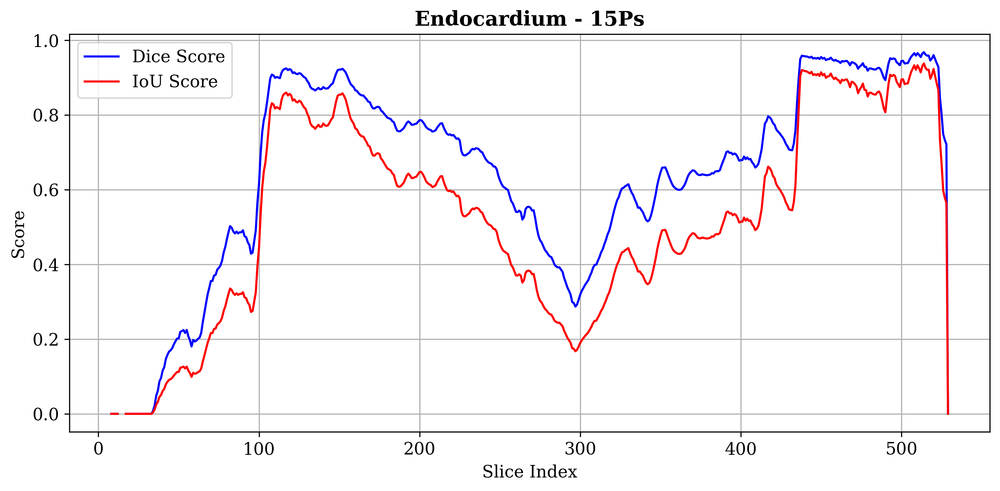

In [4]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import json
import os 

mpl.rcParams['font.family'] = 'DejaVu Serif'
mpl.rcParams['font.size'] = 12

file = "/Users/dbattagodage/Desktop/Datasets/Model_results/IF_352_6img_results/nnUNetTrainerUMambaEncNoAMP__nnUNetPlans__3d_fullres/all_segs_no_bg_linux/Evaluation_summary_perslice.json"
with open(file, 'r') as f:
    data = json.load(f)

metric_per_case = data["metric_per_case"]
required_case = metric_per_case[0] ## case ID - 1
Dice = required_case["metrics"]["3"]["Dice_through_z_axis"]
IoU = required_case["metrics"]["3"]["IoU_through_z_axis"]

plt.figure(figsize=(10, 5), dpi =300)

plt.plot(Dice, label='Dice Score', color='blue')
plt.plot(IoU, label='IoU Score', color='red')
plt.xlabel('Slice Index')
plt.ylabel('Score')
plt.title('Endocardium - 15Ps', fontweight='bold')
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.savefig('0001_3.pdf', format='pdf', dpi=300)
plt.show()


In [46]:
import nibabel as nib
import numpy as np  
import matplotlib.pyplot as plt
import matplotlib as mpl

mpl.rcParams['font.family'] = 'DejaVu Serif'
mpl.rcParams['font.size'] = 12

img = nib.load('/Users/dbattagodage/Desktop/Datasets/nnUnet_raw/Dataset352_IF_renamed_to_match_linux/imagesTr/IF_Tr_0001_0001.nii.gz').get_fdata()


/var/folders/s9/h885szvn1yj9v042sc1yjsb80000gr/T/ipykernel_47786/4195797826.py:33: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


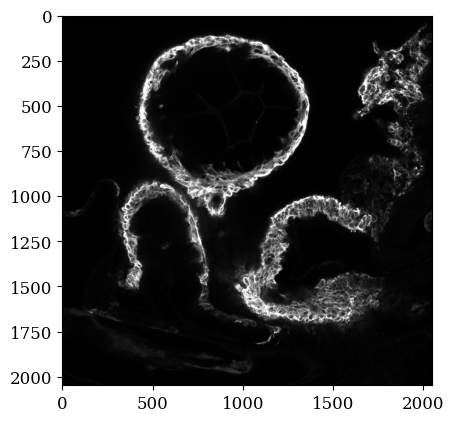

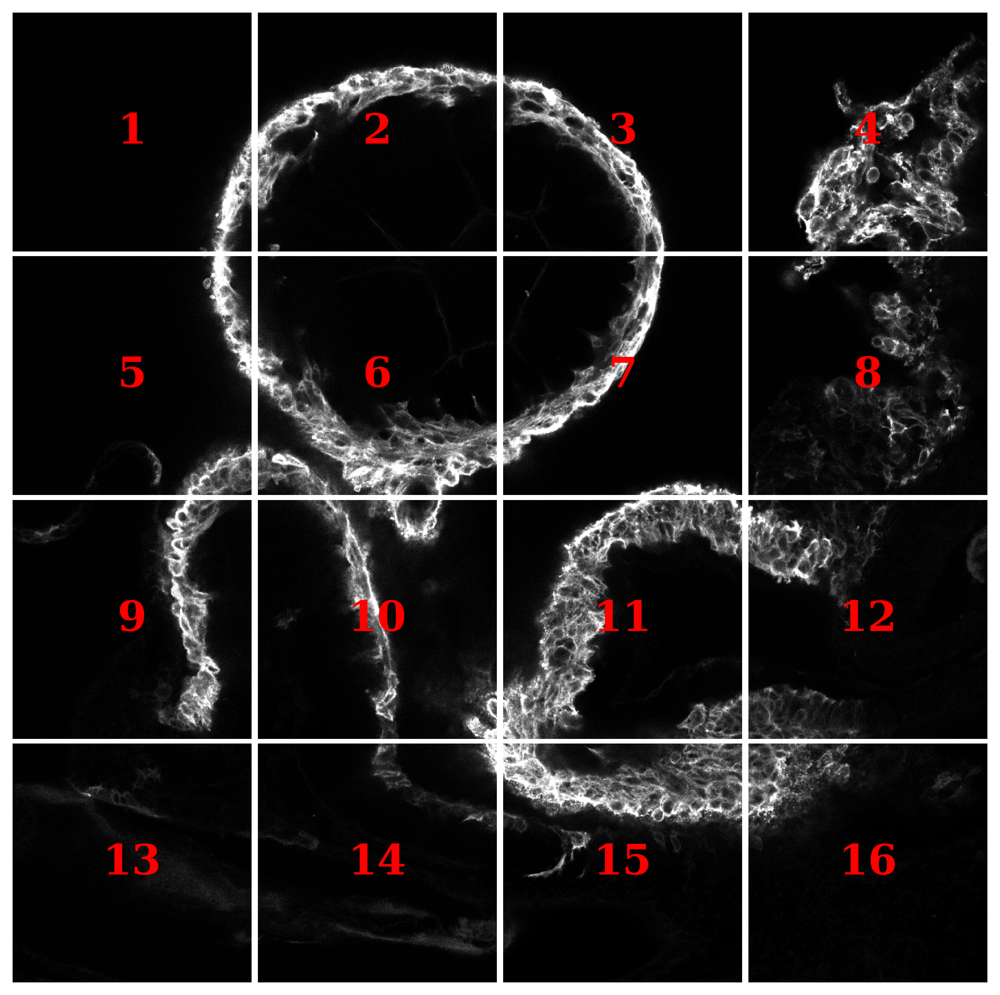

In [61]:
img_slice = img[:, :, img.shape[2] // 2]
plt.imshow(img_slice, cmap='gray')
# Split the image into 16 equal parts and visualize them as a grid
from matplotlib.gridspec import GridSpec

fig = plt.figure(figsize=(10, 10), dpi=300)
gs = GridSpec(4, 4, figure=fig, wspace=0.02, hspace=0.02)

for i in range(16):
    ax = fig.add_subplot(gs[i // 4, i % 4])

    row = i // 4
    col = i % 4

    sub_img = img_slice[
        row * (img.shape[0] // 4):(row + 1) * (img.shape[0] // 4),
        col * (img.shape[1] // 4):(col + 1) * (img.shape[1] // 4)
    ]

    ax.imshow(sub_img, cmap='gray')
    ax.axis('off')

    # 🔢 centered number (1–16)
    ax.text(
        0.5, 0.5, str(i + 1),
        transform=ax.transAxes,
        ha='center',
        va='center',
        fontsize=24,
        color='red',
        weight='bold'
    )
plt.tight_layout()

plt.subplots_adjust(wspace=0.01, hspace=0.01)
plt.savefig('Image_Grid_0001_0001.pdf', format='pdf', dpi=300)


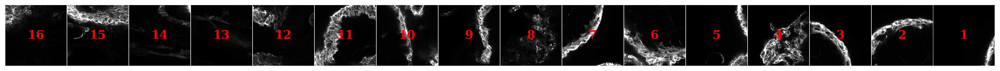

In [84]:
fig = plt.figure(figsize=(24, 3), dpi=300)  # ← wide & short
gs = GridSpec(1, 16, figure=fig, wspace=0.01)

for i in range(16):
    ax = fig.add_subplot(gs[0, i])


    row = i // 4
    col = i % 4
    sub_img = img_slice[
        img.shape[0]-(row + 1) * (img.shape[0] // 4):img.shape[0]-row * (img.shape[0] // 4),
        img.shape[1]-(col + 1) * (img.shape[1] // 4):img.shape[1]-col * (img.shape[1] // 4)
    ]

    # sub_img = img_slice[
    #     i * (img.shape[0] // 16):(i + 1) * (img.shape[0] // 16),
    #     :
    # ]

    ax.imshow(sub_img, cmap='gray')
    ax.axis('off')

    ax.text(
        0.5, 0.5, str(16 -i ),  
        transform=ax.transAxes,
        ha='center',
        va='center',
        fontsize=16,   # ↓ smaller text
        color='red',
        weight='bold'
    )

plt.savefig(
    'Image_1x16_Grid_4.pdf',
    format='pdf',
    dpi=300,
    bbox_inches='tight'
)
plt.show()


In [1]:
import nibabel as nib
import numpy as np  
import matplotlib.pyplot as plt
import matplotlib as mpl


mpl.rcParams['font.family'] = 'DejaVu Serif'
mpl.rcParams['font.size'] = 12

endo_img = "/Users/dbattagodage/Desktop/Datasets/To_segment/YenTest_Ki67/Ki67_Ts_0003_0000.nii.gz"
myo_img = "/Users/dbattagodage/Desktop/Datasets/To_segment/YenTest_Ki67/Ki67_Ts_0003_0001.nii.gz"
nuclei_img = "/Users/dbattagodage/Desktop/Datasets/To_segment/YenTest_Ki67/Ki67_Ts_0003_0002.nii.gz"
endo = nib.load(endo_img).get_fdata().astype(np.uint8)
myo = nib.load(myo_img).get_fdata().astype(np.uint8)
nuclei = nib.load(nuclei_img).get_fdata().astype(np.uint8)



In [2]:
segment = "/Users/dbattagodage/Desktop/Datasets/To_segment/YenTest_Ki67/Yen_out_folder/230613_WIF#22_WT_Ki67_CD31_10ps_#2.nii"
seg = nib.load(segment).get_fdata().astype(np.uint8)

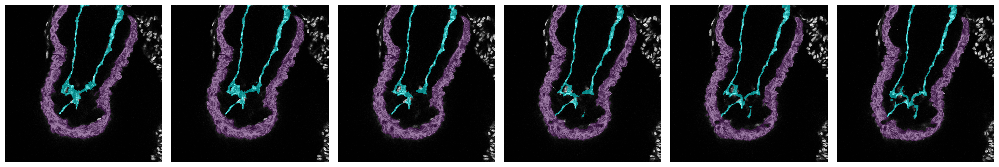

In [12]:
img = np.maximum.reduce([endo, myo, nuclei])

fig , ax = plt.subplots(1,6, figsize=(20,10), dpi=300)

for r, i in enumerate(range(101, 107)): 
    mid_slice = i

# 2. Create the boolean mask for class 2
    mask1 = (seg[:, :, mid_slice] == 2)
    mask2 = (seg[:, :, mid_slice] == 3)
    # mask3 = (seg[:, :, mid_slice] == 4)
    # mask4 = (seg[:, :, mid_slice] == 5)
    # 3. Mask the 'False' values (where the condition is 0)
    # This tells matplotlib NOT to render these pixels at all
    masked_seg1 = np.ma.masked_where(mask1 == 0, mask1)
    masked_seg2 = np.ma.masked_where(mask2 == 0, mask2)
    # masked_seg3 = np.ma.masked_where(mask3 == 0, mask3)
    # masked_seg4 = np.ma.masked_where(mask4 == 0, mask4)
    ax[r].imshow(img[:, :, mid_slice], cmap='gray')
    ax[r].imshow(masked_seg1, cmap='viridis', alpha=0.5)
    ax[r].imshow(masked_seg2, cmap='cool', alpha=0.5)
    ax[r].axis('off')
plt.tight_layout()
plt.savefig('101_106.pdf', format='pdf', dpi=300)
plt.show()

# plt.figure(figsize=(10, 10), dpi=300)

# # Show original image
# plt.imshow(img[:, :, mid_slice], cmap='gray')

# # Show only the masked segmentation
# # Now only the 'True' values will be colored with 'viridis'
# plt.imshow(masked_seg1, cmap='viridis', alpha=0.5)
# plt.imshow(masked_seg2, cmap='jet', alpha=0.5)

# plt.axis('off')
# plt.tight_layout()
# plt.savefig('101.pdf', format='pdf', dpi=300)
# plt.show()



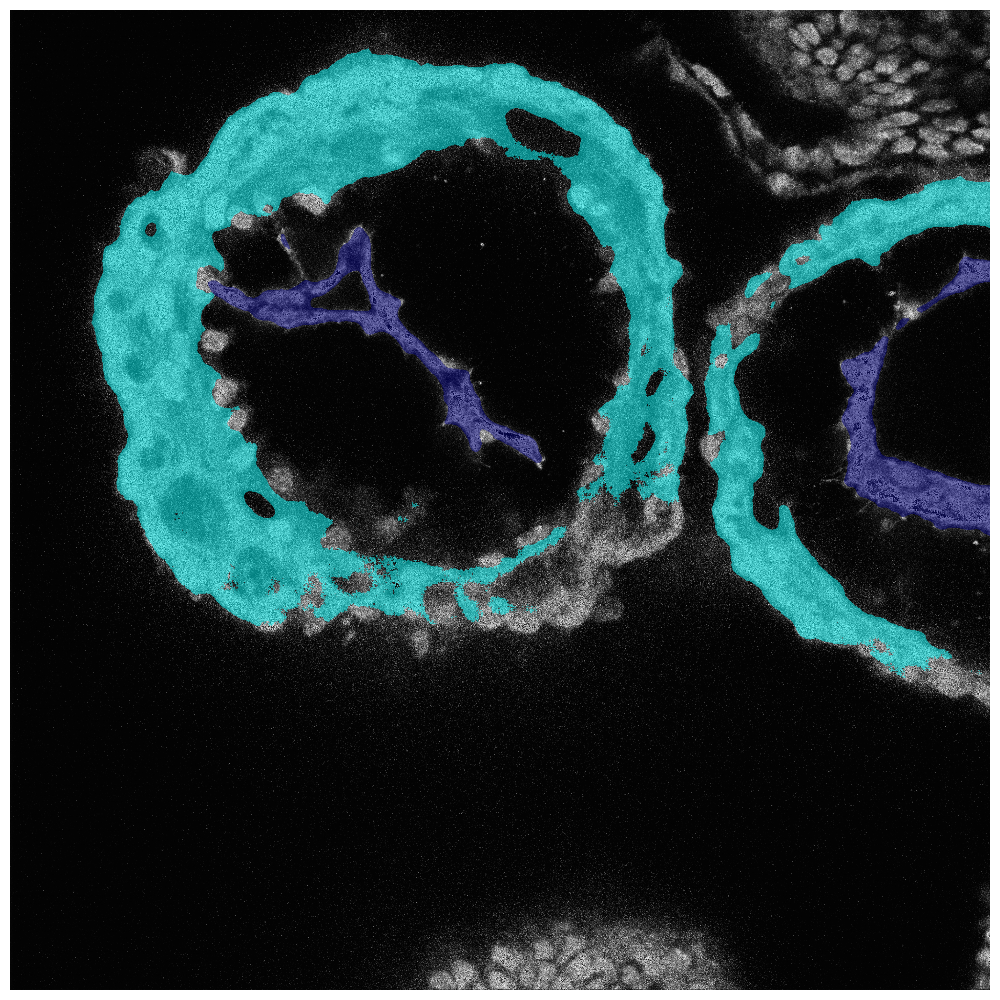

In [10]:
plt.figure(figsize=(10, 10), dpi=300)
plt.imshow(img[:, :, mid_slice], cmap='gray')
plt.imshow(masked_seg1, cmap='cool', alpha=0.5)
plt.imshow(masked_seg2, cmap='jet', alpha=0.5)
# plt.imshow(masked_seg3, cmap='Wistia', alpha=0.5)
# plt.imshow(masked_seg4, cmap='summer', alpha=0.5)

plt.axis('off')
plt.tight_layout()
plt.savefig('Overlay_0001_3_4_5_6.png', format='png', dpi=300)
plt.show()  